In [2]:
%load_ext autoreload
%matplotlib inline
%autoreload 2

In [3]:
import sys
import os
import pickle5 as pickle


import matplotlib.pyplot as plt
import seaborn as sns
sys.path.append("/Users/jsamaran/Projects/MUI")

from benchmark.plot_final_figs import plot_metrics, plot_bench_umaps, 

import scanpy as sc
from tueplots import axes as tue_axes
from tueplots import cycler as tue_cycler
from tueplots.constants.color import palettes as tue_palettes

sc.set_figure_params(vector_friendly=True, dpi_save=300)

# Configure the plots.
plt.rcParams.update({"figure.dpi": 80})
plt.rcParams.update(tue_axes.spines(left=True, right=False, top=False, bottom=True))
plt.rcParams.update(tue_axes.grid())
plt.rcParams.update(tue_cycler.cycler(color=tue_palettes.high_contrast))
plt.rcParams.update(tue_axes.legend(shadow=False, frameon=False, fancybox=False))

/Users/jsamaran/miniconda3/envs/mui/lib/python3.10/site-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: 'dlopen(/Users/jsamaran/miniconda3/envs/mui/lib/python3.10/site-packages/torchvision/image.so, 0x0006): Symbol not found: __ZN3c106detail19maybe_wrap_dim_slowIxEET_S2_S2_b
  Referenced from: <9A4710B9-0DA3-36BB-9129-645F282E64B2> /Users/jsamaran/miniconda3/envs/mui/lib/python3.10/site-packages/torchvision/image.so
  Expected in:     <1E9FA061-EA31-3736-81D0-79A33B965097> /Users/jsamaran/miniconda3/envs/mui/lib/python3.10/site-packages/torch/lib/libc10.dylib'If you don't plan on using image functionality from `torchvision.io`, you can ignore this warning. Otherwise, there might be something wrong with your environment. Did you have `libjpeg` or `libpng` installed before building `torchvision` from source?
  warn(
/Users/jsamaran/miniconda3/envs/mui/lib/python3.10/site-packages/torch/utils/tensorboard/__init__.py:4: DeprecationWarning: distutils

In [4]:
results = pickle.load(open("exp_results/bench_rez.pickle", "rb"))

/var/folders/1k/ggmt2mb53m320bxwd70cn3wc69xyl8/T/ipykernel_15411/4133974202.py:1: ResourceWarning: unclosed file <_io.BufferedReader name='exp_results/bench_rez.pickle'>
  results = pickle.load(open("exp_results/bench_rez.pickle", "rb"))


In [5]:
save_path = "./saved_bench_figures"
if not os.path.exists(save_path):
    os.mkdir(save_path)

In [6]:
knn_metrics = ['purity', "celltype_transfer"]
bar_metrics = ["foscttm_full"]
metrics_to_plot = knn_metrics + bar_metrics
method_names = list(results["pbmc10X"].keys())
k_array = [5, 10, 15, 20, 35, 50]
palette = sns.color_palette("Set2", n_colors=7)
colors = {meth_name: palette[k] for k, meth_name in enumerate(method_names)} 

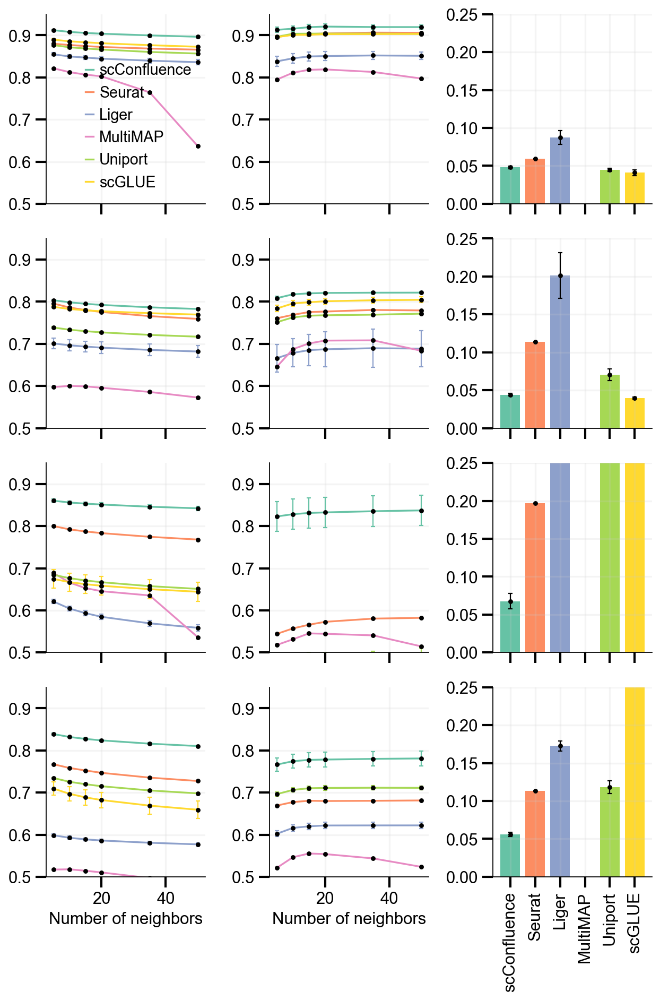

In [10]:
plot_metrics(results=results, knn_metrics=knn_metrics, bar_metrics=bar_metrics, metrics_to_plot=metrics_to_plot, 
             method_names=method_names, colors=colors, k_array=k_array, save=True, save_path=save_path,
             bar_ylim=0.25, knn_ylim=(0.5, 0.95), figsize=(8, 12))

# Supplementary figure 2

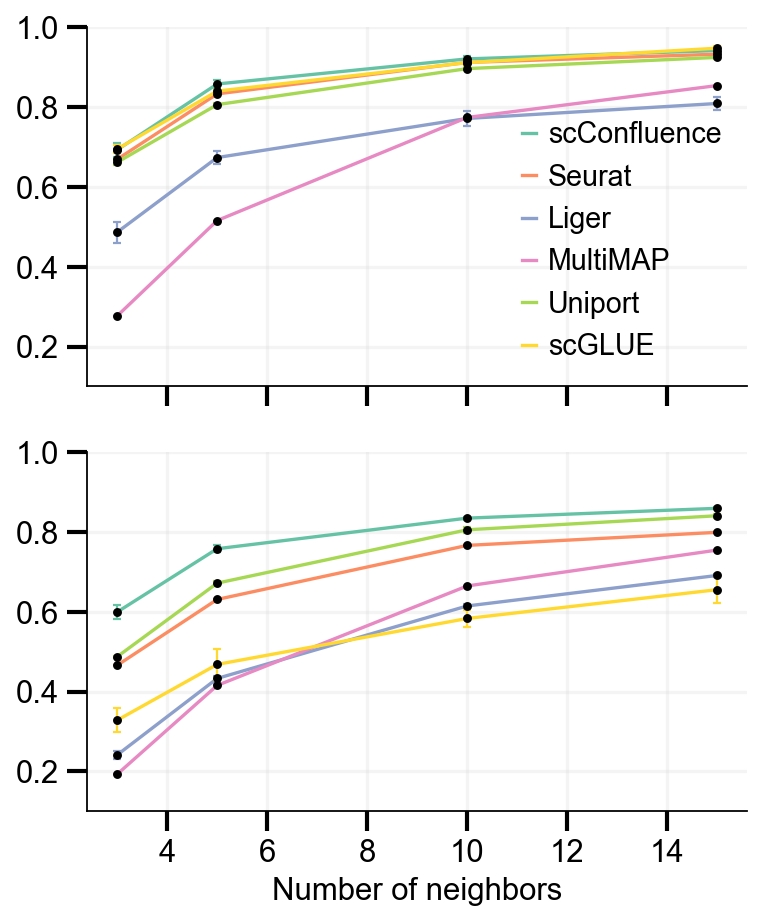

In [16]:
plot_metrics(results={"OP_Multiome": results["OP_Multiome"], "OP_Cite": results["OP_Cite"]}, 
             knn_metrics=["graph_connectivity"], 
             bar_metrics=[], figsize=(5, 6),
             metrics_to_plot=["graph_connectivity"], 
             method_names=method_names, colors=colors, k_array=[3, 5, 10, 15], save=True, bar_ylim=0.21, 
             knn_ylim=(0.1, 1.), save_path=save_path, 
             title="connectivity")

# Plotting UMAPS (and Supplementary Figures 3-6)

In [17]:
with open("exp_results/bench_rez_adatas.pickle", "rb") as f:
    adatas = pickle.load(f)

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.
Traceback (most recent call last):
  File "/Users/jsamaran/Library/Application Support/JetBrains/Toolbox/apps/PyCharm-P/ch-0/233.13763.11/PyCharm.app/Contents/plugins/python/helpers/pydev/_pydevd_bundle/pydevd_comm.py", line 387, in _on_run
    cmd.send(self.sock)
  File "/Users/jsamaran/Library/Application Support/JetBrains/Toolbox/apps/PyCharm-P/ch-0/233.13763.11/PyCharm.app/Contents/plugins/python/helpers/pydev/_pydevd_bundle/pydevd_comm.py", line 548, in send
    sock.sendall(as_bytes)
BrokenPipeError: [Errno 32] Broken pipe

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/Users/jsamaran/Library/Application Support/JetBrains/Toolbox/apps/PyCharm-P/ch-0/233.13763.11/PyCharm.app/Contents/plugins/python/helpers/pydev/_pydevd_bundle/pydevd_comm.py", line 219, in run
    self._on_run()
  File "/Users/jsamaran/Library/Applicatio

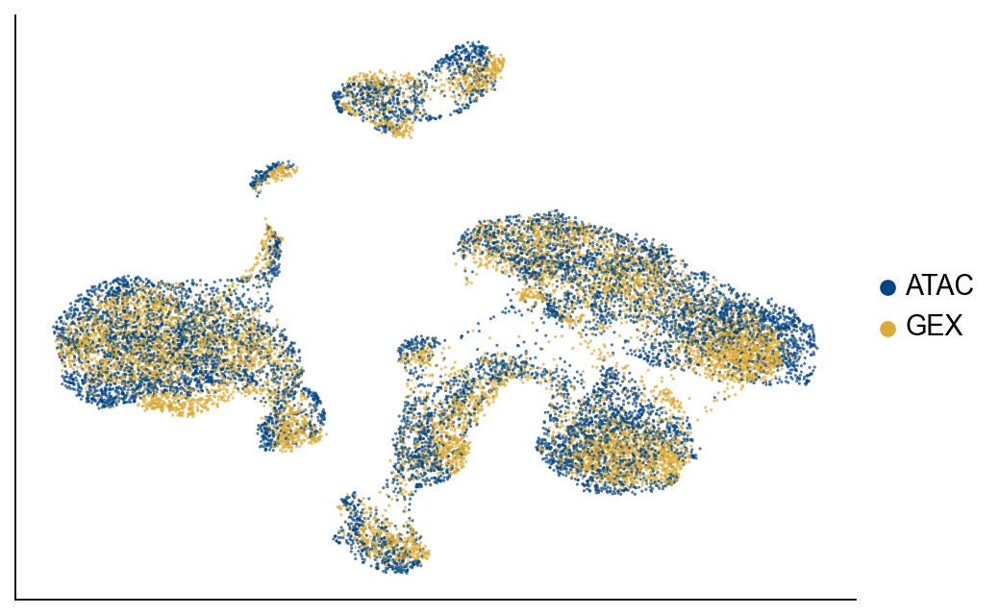

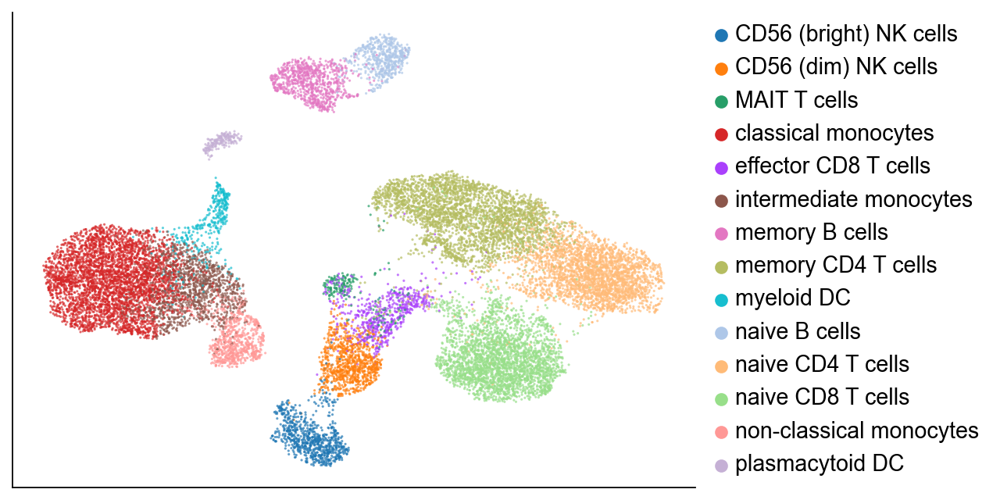

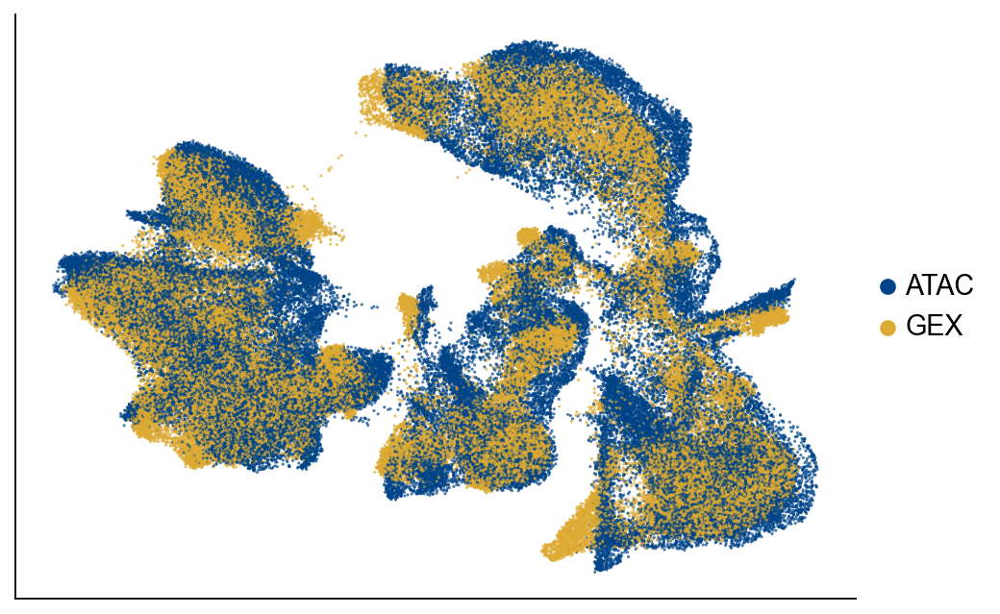

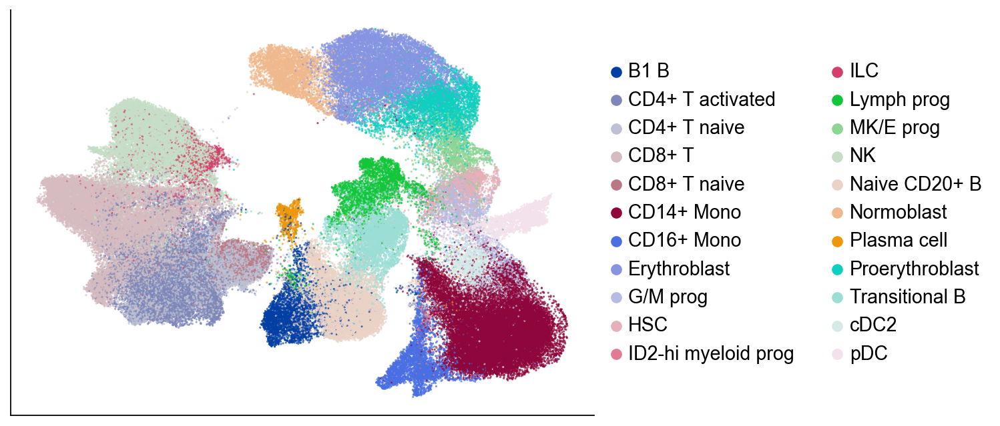

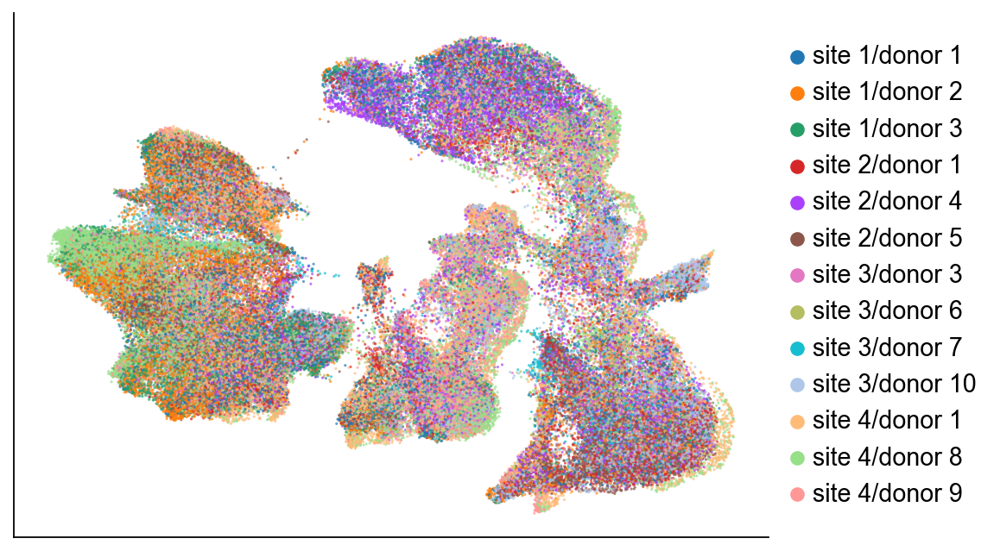

...

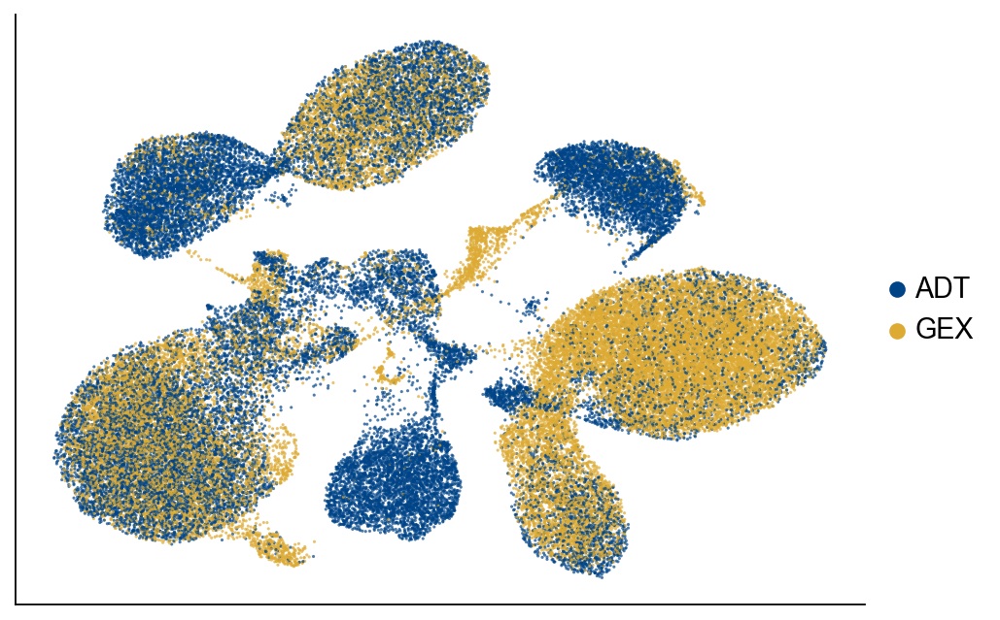

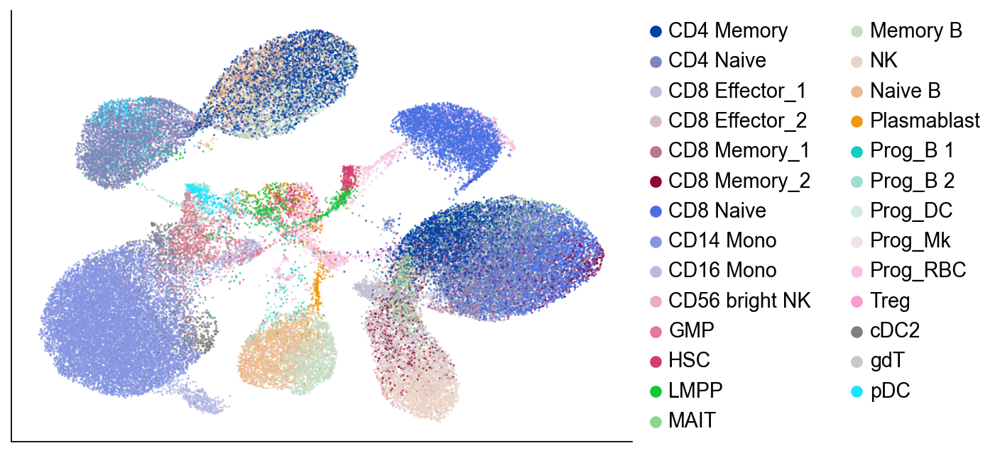

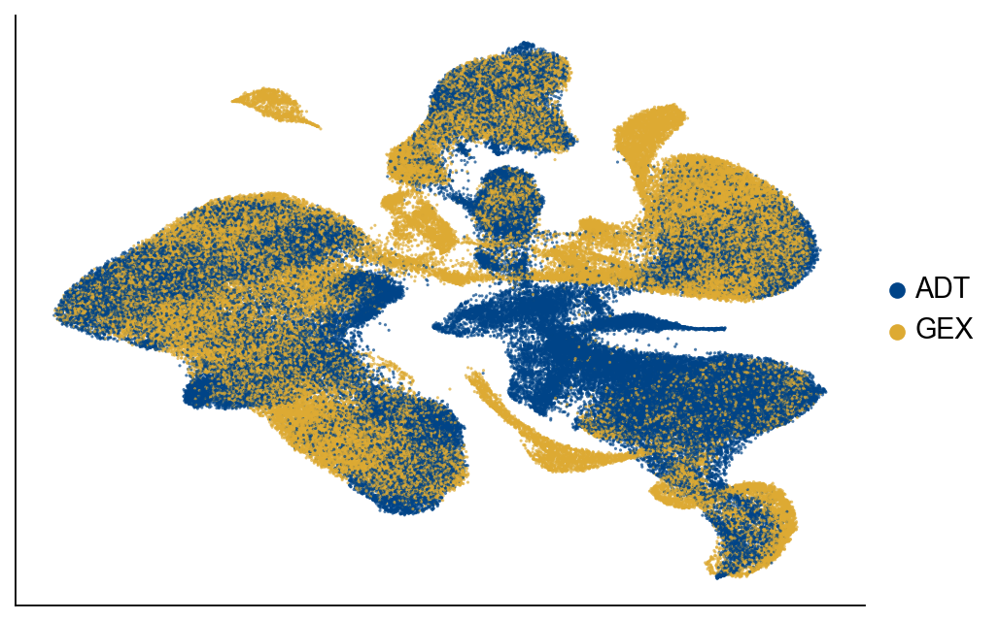

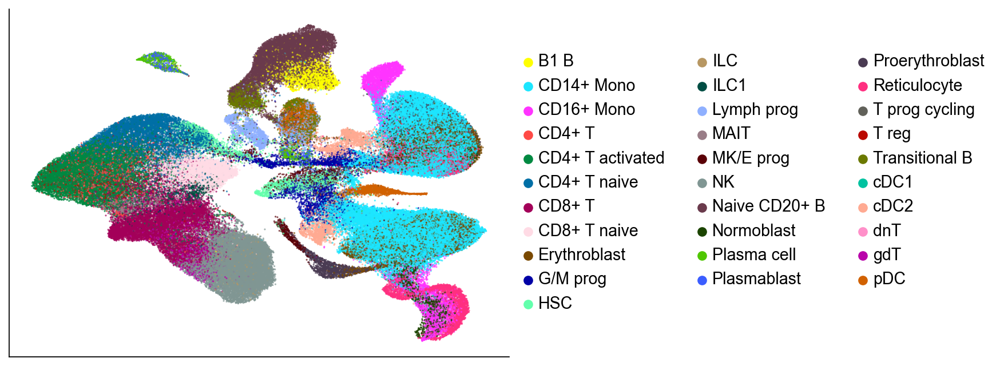

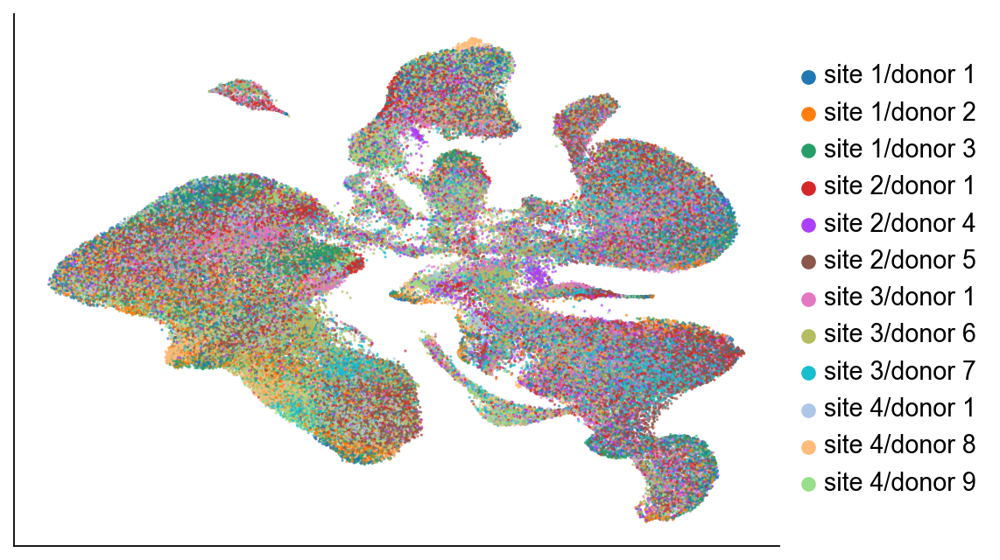

In [19]:
plots = {"pbmc10X": ["modality", "celltype"],
         "OP_Multiome": ["modality", "celltype", "batch"], 
         "bmcite": ["modality", "celltype"], 
         "OP_Cite": ["modality", "celltype", "batch"]}
for meth_name in method_names:
    plot_bench_umaps(adatas=adatas, plots=plots, s=8, n_neigh=20, save_path=save_path, method_name=meth_name) # we rerun with s=15 only for PBMC10X